In [1]:
# # Parameters
config_file <- "config.yml"
wgcna_name <- "Consensus_T1"

In [2]:
msg <- paste0("# ", wgcna_name, ": hdWGCNA main analysis")
IRdisplay::display_markdown(msg)

# Consensus_T1: hdWGCNA main analysis

1. Load libraries, data, functions
2. Load the the Seurat object, the hdWGCNA config file, validate the selected options
3. Subset the Seurat object as specified 

## Load libraries and helper functions

Here we load the necessary R libraries for running `hdWGCNA`, such as `Seurat`, `igraph`, `WGCNA`, etc. We also load the helper functions and plotting functions within the snakemake directory

In [3]:
# input handling packages
library(yaml)
library(assertthat)

# data wrangling & plotting packages
library(tidyverse)
library(patchwork)
library(cowplot)
library(RColorBrewer)
library(crayon)

# single-cell & data analysis packages
library(Seurat)
library(Matrix)

# network analysis
library(WGCNA)
library(hdWGCNA)
library(igraph)
library(ggraph)
library(tidygraph)

# interactive elements etc
library(DT)
library(IRdisplay)
library(glue)
library(plotly)

# set the plotting theme
theme_set(theme_cowplot())

# source helper functions
# TODO: this should be relative to the snakemake, rather than to the home dir.
source("scripts/helper_functions.R")
source("scripts/plotting_functions.R")


── Attaching core tidyverse packages ────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.2
✔ ggplot2   3.5.2     ✔ tibble    3.3.0
✔ lubridate 1.9.4     ✔ tidyr     1.3.1
✔ purrr     1.1.0     
── Conflicts ──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter()    masks stats::filter()
✖ tibble::has_name() masks assertthat::has_name()
✖ dplyr::lag()       masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors

Attaching package: ‘cowplot’


The following object is masked from ‘package:patchwork’:

    align_plots


The following object is masked from ‘package:lubridate’:

    stamp



Attaching package: ‘crayon’


The following o

## Load the dataset and the config file

Here we load the config file, and validate the specified options. 

In [4]:
# validate the config file, load the Seurat object
result <- load_and_validate_config(config_file, wgcna_name, verbose=TRUE)
config <- result$config
seurat_obj <- result$seurat

# show basic info about the Seurat object:
seurat_obj

🔍 Reading configuration file: config.yml 
⚙️ Recompute network for 'Consensus_T1': FALSE 
📦 Skipping recomputation — attempting to load processed hdWGCNA object... 
⚠️ Processed network object not found. 
➡️ Falling back to raw Seurat object instead (recompute forced). 
✅ Loaded raw Seurat object with 358100 cells. 
✅ [SetupForWGCNA] Metadata column 'annotation' found. 
✅ [MetacellsByGroups] Metadata column 'annotation' found. 
✅ [MetacellsByGroups] Metadata column 'Tissue' found. 
✅ [MetacellsByGroups] Metadata column 'annotation' found. 
🌐 Checking network: Consensus_T1 
✅ [Consensus_T1] Metadata column 'annotation' found. 
✅ [Consensus_T1] Metadata column 'Patient' found. 
✅ [Consensus_T1 subset] Metadata column 'Primary_tumor' found. 
✅ [Consensus_T1 subset] All specified values found in 'Primary_tumor'. 
✅ [Consensus_T1 subset] Metadata column 'Tissue' found. 
✅ [Consensus_T1 subset] All specified values found in 'Tissue'. 
✅ [Consensus_T1 subset] Metadata column 'Timepoint' found

An object of class Seurat 
30548 features across 358100 samples within 1 assay 
Active assay: RNA (30548 features, 2130 variable features)
 2 layers present: counts, data
 3 dimensional reductions calculated: X_pca_CellANOVA, Cmat, X_umap

In [5]:
# manually load the config file:
# config <- yaml::read_yaml(config_file)

From the config file, we get the general options `gen_opts` and the options specific for this network `net_opts`. We also create the output directories.

In [6]:
# get the options for the current network
gen_opts <- config$general
net_opts <- config$networks[[wgcna_name]]
consensus_opts <- net_opts$consensus
IRdisplay::display_markdown(make_markdown_summary(gen_opts))

# optionally enable multithreading
enableWGCNAThreads(nThreads = gen_opts$cores)

# if the network is missing, override the recompute_network option:
# else, make sure the Active WGCNA is re-set based on the input params
if(!(wgcna_name %in% names(seurat_obj@misc))){
    net_opts$recompute_network <- TRUE
} else {
    seurat_obj <- hdWGCNA::SetActiveWGCNA(seurat_obj, wgcna_name = wgcna_name)
}

# move directories
# this is essential, since tmp files for the hdWGCNA TOM could have
# issues if multiple networks are processed at once in the same directory.
net_dir <- paste0(gen_opts$out_dir, '/', wgcna_name)
dir.create(net_dir)
setwd(net_dir)

# set up & create output directories
fig_dir <- paste0(gen_opts$fig_dir, '/')
data_dir <- paste0(gen_opts$data_dir, '/')
dir.create(fig_dir, recursive = TRUE)
dir.create(data_dir, recursive = TRUE)



| Option | Value |
|--------|--------|
| out dir | results/ |
| fig dir | figures/ |
| data dir | data/ |
| cores | 8 |
| reduction plot | X_umap |
| nb dpi | 150 |
| global metacells | TRUE |

Allowing parallel execution with up to 8 working processes.


Warning message in dir.create(net_dir):
“'results//Consensus_T1' already exists”
Warning message in dir.create(fig_dir, recursive = TRUE):
“'figures' already exists”
Warning message in dir.create(data_dir, recursive = TRUE):
“'data' already exists”


## Subset the Seurat object



| Option | Value |
|--------|--------|
| Primary tumor | CRC |
| Tissue | Liver, Lung, Primary |
| Timepoint | 1 |

Warning message:
“`aes_string()` was deprecated in ggplot2 3.0.0.
ℹ Please use tidy evaluation idioms with `aes()`.
ℹ See also `vignette("ggplot2-in-packages")` for more information.”


[1]  30548 113300


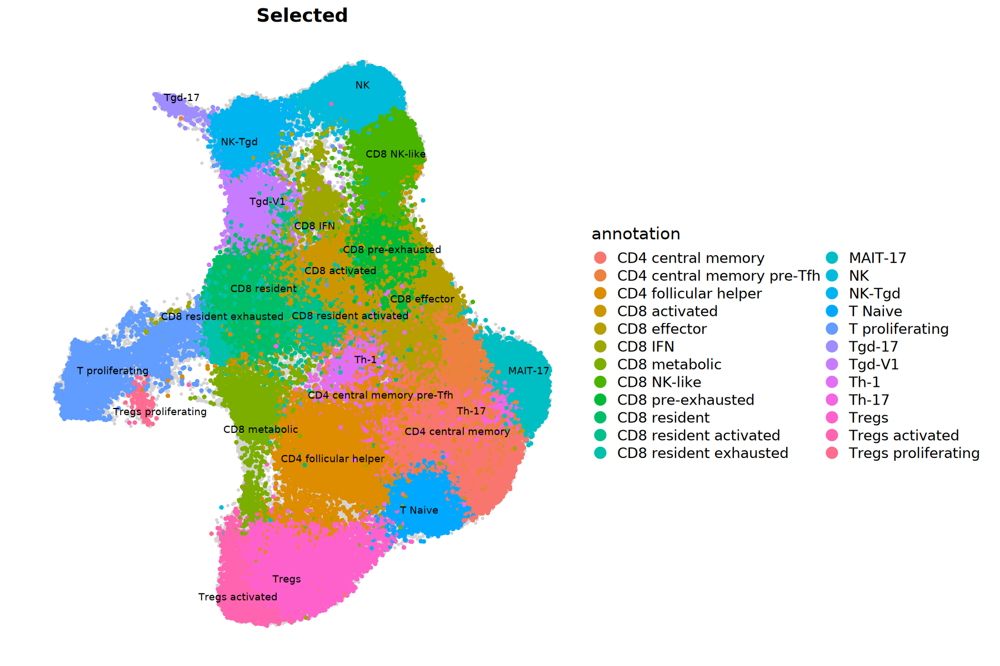

In [8]:
# get subset options
subset_opts <- net_opts$subset
IRdisplay::display_markdown(make_markdown_summary(subset_opts))

if(net_opts$recompute_network){

    # get the list of barcodes to subset by
    bcs_keep <- list()
    for(i in 1:length(subset_opts)){
        cur_col <- names(subset_opts)[i]
        cur_groups <- subset_opts[[i]]
        bcs_keep[[i]] <- seurat_obj@meta.data %>% 
            subset(get(cur_col) %in% cur_groups) %>% 
            rownames()
    }
    bcs_keep <- Reduce(intersect, bcs_keep)
    
    seurat_obj$hdWGCNA_selected <- factor(
        ifelse(colnames(seurat_obj) %in% bcs_keep, "Selected", "Other"), 
        levels = c("Selected", "Other")
    )
    
    # get params for this plot
    opts <- config$PlotEmbedding
    width <- opts$width; height <- opts$height
    
    # set the plotting area for the notebook
    options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)
    
    if(opts$plot){
        
        # generate plot
        plot_list <- PlotEmbedding(
            seurat_obj,
            group.by = net_opts$group.by,
            split.by = 'hdWGCNA_selected',
            reduction = gen_opts$reduction_plot,
            plot_theme = umap_theme(),
            raster = opts$raster,
            raster_dpi = opts$raster_dpi,
            raster_scale = opts$raster_scale,
            point_size = opts$point_size,
            plot_under = opts$plot_under,
            label = opts$label,
            legend_point_size = opts$legend_point_size,
            text_size = opts$text_size,
        )
        
        # save plot to .pdf
        pdf(paste0(fig_dir, wgcna_name,'_umap_', net_opts$group.by, '.pdf'), width=width, height=height)
        print(plot_list[["Selected"]])
        dev.off()
        
        # show the plot in the notebook
        print(plot_list[["Selected"]])
    }

    # perform the subset operation:
    seurat_obj <- seurat_obj[,seurat_obj$hdWGCNA_selected == "Selected"]
    print(dim(seurat_obj))

}

# Part 2: Run hdWGCNA

In this section, we perform the main analysis steps of the hdWGCNA pipeline.
* Set up the Seurat object for hdWGCNA, perform Feature Selection (`SetupForWGCNA`)
* Aggregate cells into Metacells (`MetacellsByGroups`)
* Define the gene expression matrix used for network analysis (`SetDatExpr`)
* Test soft-thresholding parameters vs. network topology measures (`TestSoftPowers`)
* Construct the co-expression network and group genes into highly co-expressed **gene modules** (`ConstructNetwork`)
* Calculate **Module Eigengenes**, cell-level gene expression scores for each co-expression module (`ModuleEigengenes`)
* Calculate **eigengene connectivity** for each gene and each module (`ModuleConnectivity`) 


## SetupForWGCNA

* Creates a slot in the `seurat_obj@misc` for the current network.
* Selects features that will be used for network analysis.

In [9]:
# get the options from the config file
opts <- config$SetupForWGCNA
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    
    # run the function
    seurat_obj <- hdWGCNA::SetupForWGCNA(
        seurat_obj,
        features = opts$features,
        metacell_location = opts$metacell_location,
        gene_select = opts$gene_select,
        fraction = opts$fraction, 
        group.by = opts$group.by,
        wgcna_name = wgcna_name
    )
    
    # print the number of genes that will be used for hdWGCNA:
    print(length(GetWGCNAGenes(seurat_obj)))
}



| Option | Value |
|--------|--------|
| features | default |
| metacell location | default |
| gene select | fraction |
| fraction | 0.05 |
| group.by | annotation |
| gene list | default |
| assay | RNA |

[1] 10563


## MetacellsByGroups

Here we aggregate highly similar cells, based on a given dimensionality reduction like PCA, into `Metacells`. This process reduces the sparsity of the gene expression matrix while retaining cellular heterogeneity, which is ideal for the downstream co-expression network analysis. 

In [10]:
# get the options from the config file
opts <- config$MetacellsByGroups
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    
    # run the function
    seurat_obj <- hdWGCNA::MetacellsByGroups(
        seurat_obj = seurat_obj,
        group.by = opts$group.by,
        ident.group = opts$ident.group,
        k = opts$k,
        reduction = opts$reduction,
        dims = opts$dims,
        assay = opts$assay,
        slot = opts$slot,
        layer = opts$layer,
        mode = opts$mode,
        max_shared = opts$max_shared,
        target_metacells = opts$target_metacells,
        min_cells = opts$min_cells,
        max_iter = opts$max_iter,
        verbose = opts$verbose,
        wgcna_name = wgcna_name
    )
    
    # normalize metacell expression matrix:
    seurat_obj <- NormalizeMetacells(seurat_obj)

    #--------------------------------------------------------------------#
    # Metacell dimreduct plot
    #--------------------------------------------------------------------#
    
    m_obj <- GetMetacellObject(seurat_obj)
    
    tmp <- seurat_obj@reductions[[gen_opts$reduction_plot]]
    reduction <- tmp@cell.embeddings[,1:2]
    
    # loop over each metacell and calculate the average X and Y
    meta_reduction <- do.call(rbind, lapply(1:ncol(m_obj), function(i){
      x <- m_obj@meta.data$cells_merged[i]
      cur_bcs <- str_split(x, ',')[[1]]
      cur_df <- reduction[cur_bcs,]
      cur_x <- mean(cur_df[,1])
      cur_y <- mean(cur_df[,2])
      data.frame(x = cur_x, y = cur_y)
    }))
    rownames(meta_reduction) <- colnames(m_obj)
    colnames(meta_reduction) <- colnames(reduction)
    meta_reduction <- as.matrix(meta_reduction)
    
    m_obj@reductions[[gen_opts$reduction_plot]] <- Seurat::CreateDimReducObject(
        meta_reduction, 
        key = gen_opts$reduction_plot, 
        assay = DefaultAssay(m_obj)
    )
    
    # update the metacell object in the seurat object
    seurat_obj <- SetMetacellObject(seurat_obj, m_obj, wgcna_name = wgcna_name)
    
}



| Option | Value |
|--------|--------|
| group.by | annotation, Tissue |
| ident.group | annotation |
| k | 50 |
| reduction | X_pca_CellANOVA |
| dims | default |
| assay | default |
| slot | counts |
| layer | counts |
| mode | average |
| cells.use | default |
| min cells | 125 |
| max shared | 10 |
| target metacells | 100 |
| max iter | 5000 |
| verbose | FALSE |

Warning message:
“The `slot` argument of `GetAssayData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead.
ℹ The deprecated feature was likely used in the hdWGCNA package.
  Please report the issue to the authors.”
Warning message in hdWGCNA::MetacellsByGroups(seurat_obj = seurat_obj, group.by = opts$group.by, :
“Removing the following groups that did not meet min_cells: Tregs proliferating#Liver, Tregs proliferating#Lung, Tregs proliferating#Primary”
Normalizing layer: counts

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from X_umap to Xumap_”


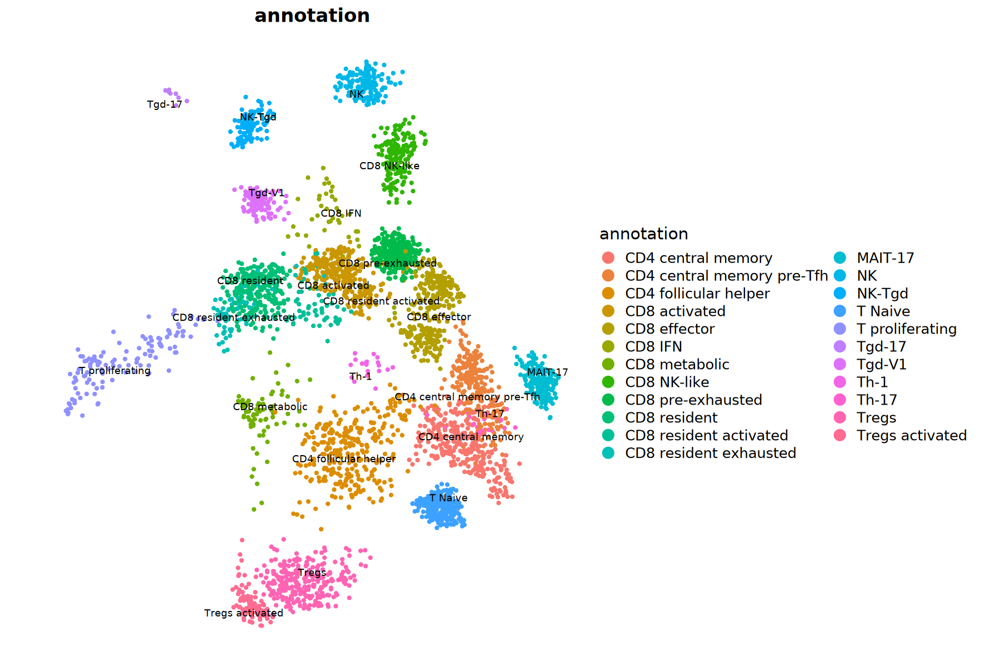

In [11]:
# get params for this plot
opts <- config$PlotEmbedding
width <- opts$width; height <- opts$height

# set the plotting area for the notebook
options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)

if(opts$plot){
    
    # generate plot
    p <- PlotEmbedding(
        GetMetacellObject(seurat_obj, wgcna_name),
        group.by = net_opts$group.by,
        reduction = gen_opts$reduction_plot,
        plot_theme = umap_theme(),
        raster = opts$raster,
        raster_dpi = opts$raster_dpi,
        raster_scale = opts$raster_scale,
        point_size = opts$point_size,
        plot_under = opts$plot_under,
        label = opts$label,
        legend_point_size = opts$legend_point_size,
        text_size = opts$text_size,
    )
    
    # save plot to .pdf
    pdf(paste0(fig_dir, wgcna_name,'_umap_', net_opts$group.by, '_metacell.pdf'), width=width, height=height)
    print(p)
    dev.off()

    print(p)
    
}

## SetDatExpr

Here we set up the gene expression matrix that will be used for constructing the co-expression network. We use the **Metacell** representation of the dataset rather than the raw single-cell data, and we use cells/metacells specified by the `group.by` and `group_name` parameters.


In [13]:
is.null(consensus_opts)

[1] FALSE

In [17]:
# get the options from the config file
opts <- config$SetDatExpr
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    if(is.null(consensus_opts)){    
        seurat_obj <- hdWGCNA::SetDatExpr(
            seurat_obj,
            group.by = opts$group.by,
            group_name = opts$group_name,
            slot = opts$slot,
            layer = opts$layer,
            assay = opts$assay,
            use_metacells = TRUE,
            wgcna_name = wgcna_name
        )
    } else {
        seurat_obj <- hdWGCNA::SetMultiExpr(
            seurat_obj,
            group.by = opts$group.by,
            group_name = opts$group_name,
            multi.group.by = consensus_opts$multi.group.by,
            multi_groups = consensus_opts$multi_groups,
            slot = opts$slot,
            layer = opts$layer,
            assay = opts$assay,
            use_metacells = TRUE,
            wgcna_name = wgcna_name
        )
    }
}



| Option | Value |
|--------|--------|
| group.by | default |
| group name | default |
| slot | data |
| layer | data |
| assay | RNA |

[1] "HERE"
  ..Excluding 9 genes from the calculation due to too many missing samples or zero variance.


## TestSoftPowers

We determine the **soft power threshold**, which de-noises the gene-gene correlation matrix, via a parameter sweep. For each soft power value tested, connectivity statistics for the network, and we check how much the network resembles a scale-free topology. By default, the lowest soft power that reaches a scale-free topology fit of 0.8 is selected for downstream analysis.

In [18]:
opts <- config$TestSoftPowers
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    if(is.null(consensus_opts)){    
        seurat_obj <- hdWGCNA::TestSoftPowers(
            seurat_obj,
            powers = opts$powers,
            networkType = opts$networkType,
            corFnc = opts$corFnc
        )
    } else {
        seurat_obj <- hdWGCNA::TestSoftPowersConsensus(
            seurat_obj,
            powers = opts$powers,
            networkType = opts$networkType,
            corFnc = opts$corFnc
        )
    }
}



| Option | Value |
|--------|--------|
| powers | 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30 |
| networkType | signed |
| corFnc | bicor |

[1] "AAAA"
[1] "Primary"
pickSoftThreshold: will use block size 4239.
 pickSoftThreshold: calculating connectivity for given powers...
   ..working on genes 1 through 4239 of 10554
   ..working on genes 4240 through 8478 of 10554
tem call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
R_zmq_msg_send errno: 4 strerror: Interrupted system call
4.100          0.980  128.000  1.17e+02  345.0
8      8  0.87500 -4.120          0.986   71.300  6.35e+01  239.0
9      9  0.88700 -3.960          0.985   40.500  3.45e+01  170.0
10    10  0.89700 -3.600          0.984   23.400  1.89e+01  

  Power   SFT.R.sq      slope truncated.R.sq   mean.k. median.k.   max.k.
1     1 0.60027242  9.1263231      0.7189640 6082.9066 6100.6975 6914.424
2     2 0.12861605  1.8980605      0.8475106 3269.5517 3249.3137 4373.084
3     3 0.05038953 -0.8433669      0.9750371 1792.1948 1745.1506 2886.774
4     4 0.45251288 -2.2753030      0.9455471 1001.8232  944.7816 1972.548
5     5 0.73093094 -2.7727009      0.9557329  571.3995  516.2912 1393.408
6     6 0.81416317 -2.8789102      0.9517901  332.8191  284.5994 1017.752


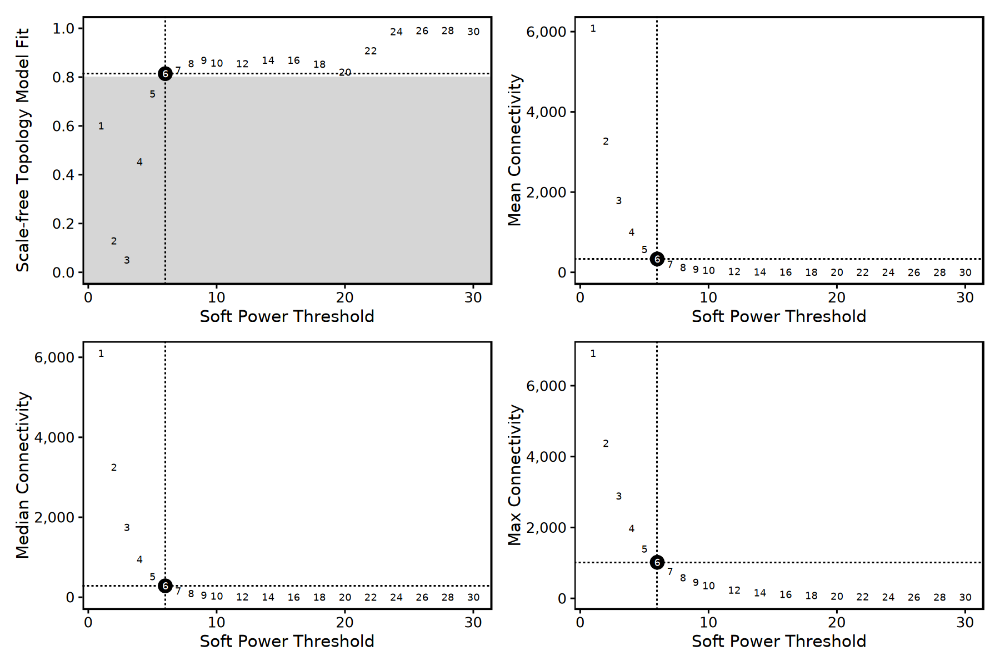

In [17]:
# get params for this plot
opts <- config$PlotSoftPowers
width <- opts$width; height <- opts$height

# set the plotting area for the notebook
options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)

if(opts$plot){

    if(is.null(consensus_opts)){    
        plot_list <- PlotSoftPowers(seurat_obj)
        patch <- wrap_plots(plot_list, ncol=2)
        
        # assemble with patchwork
        pdf(paste0(fig_dir, wgcna_name,'_softpowers.pdf'), width=width, height=height)
        print(patch)
        dev.off()
        
        print(patch)
    } else{
        print("TODO: add plotting code for consensus network")
    }
}

## ConstructNetwork

`ConstructNetwork` uses the previously defined gene expression matrix to build a gene-gene co-expression network. Hierarchical clustering of the network followed and Dynamic Tree Cutting clusters highly co-expressed genes into **modules**.  

In [18]:
# Extract parameters from config
opts <- config$ConstructNetwork
IRdisplay::display_markdown(make_markdown_summary(opts))


if(net_opts$recompute_network){
    
    # Run ConstructNetwork
    seurat_obj <- hdWGCNA::ConstructNetwork(
        seurat_obj = seurat_obj,
        soft_power = opts$soft_power,
        min_power = opts$min_power,
        tom_outdir = opts$tom_outdir,
        tom_name = opts$tom_name,
        consensus = !is.null(consensus_opts),
        overwrite_tom = opts$overwrite_tom,
        wgcna_name = wgcna_name,
        blocks = opts$blocks,
        maxBlockSize = opts$maxBlockSize,
        randomSeed = opts$randomSeed,
        corType = opts$corType,
        consensusQuantile = opts$consensusQuantile,
        networkType = opts$networkType,
        TOMType = opts$TOMType,
        TOMDenom = opts$TOMDenom,
        scaleTOMs = opts$scaleTOMs,
        calibrationQuantile = opts$calibrationQuantile,
        sampleForCalibration = opts$sampleForCalibration,
        sampleForCalibrationFactor = opts$sampleForCalibrationFactor,
        useDiskCache = opts$useDiskCache,
        chunkSize = opts$chunkSize,
        deepSplit = opts$deepSplit,
        pamStage = opts$pamStage,
        detectCutHeight = opts$detectCutHeight,
        minModuleSize = opts$minModuleSize,
        mergeCutHeight = opts$mergeCutHeight,
        saveConsensusTOMs = opts$saveConsensusTOMs
    )
}



| Option | Value |
|--------|--------|
| soft power | default |
| min power | 3 |
| tom outdir | TOM |
| tom name | default |
| consensus | FALSE |
| overwrite tom | TRUE |
| wgcna name | default |
| blocks | default |
| maxBlockSize | 30000 |
| randomSeed | 12345 |
| corType | pearson |
| consensusQuantile | 0.3 |
| networkType | signed |
| TOMType | signed |
| TOMDenom | min |
| scaleTOMs | TRUE |
| calibrationQuantile | 0.95 |
| sampleForCalibration | TRUE |
| sampleForCalibrationFactor | 1000 |
| useDiskCache | TRUE |
| chunkSize | default |
| deepSplit | 4 |
| pamStage | FALSE |
| detectCutHeight | 0.995 |
| minModuleSize | 50 |
| mergeCutHeight | 0.1 |
| saveConsensusTOMs | TRUE |

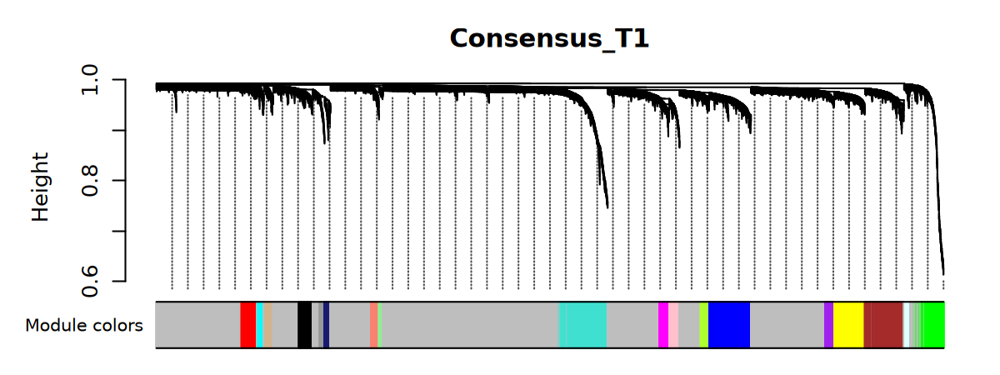

In [22]:
# get params for this plot
opts <- config$PlotDendrogram
width <- opts$width; height <- opts$height

# set the plotting area for the notebook
options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)

if(opts$plot){

    pdf(paste0(fig_dir, wgcna_name,'_dendrogram.pdf'), width=width, height=height)
    PlotDendrogram(seurat_obj, main=wgcna_name)
    dev.off()

    PlotDendrogram(seurat_obj, main=wgcna_name)
    
}

## ModuleEigengenes

Here we calculate cell-level gene expression scores for each of the co-expression modules identified in the previous step. The **Module Eigengene** is calculated as the first principal component of the gene expression matrix of the genes contained in a particular module. Other cell-level expression scores, like `UCell`, are appropriate alternatives to Module Eigengenes.

In [20]:
opts <- config$ModuleEigengenes
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    
    # create a scale.data slot if there isn't already one present in the Seurat object
    if(!("scale.data" %in% Layers(seurat_obj))){
        seurat_obj <- ScaleData(seurat_obj, features=rownames(seurat_obj)[1:100])
    }
        
    seurat_obj <- ModuleEigengenes(
        seurat_obj,
        group.by.vars = opts$group.by.vars,
        vars.to.regress = opts$vars.to.regress,
        scale.model.use = opts$scale.model.use,
        verbose = opts$verbose,
        assay = opts$assay,
        wgcna_name = wgcna_name
    )
}



| Option | Value |
|--------|--------|
| group.by.vars | Replicate |
| vars.to.regress | default |
| scale.model.use | linear |
| verbose | FALSE |
| assay | RNA |

## ModuleConnectivity

We calculate the connectivity of each gene within each of the network modules by correlating the expression level of the gene with the expression level of the whole module, to give us the **eigengene-based connectivity** (kME). We also calculate the **degree** of each gene in the network by calculating the sum of all the edge weights for a given gene. These measures of connectivity help us rank genes in terms of their importance in each module, and to identify **hub genes** in the network.

In [21]:
opts <- config$ModuleConnectivity
IRdisplay::display_markdown(make_markdown_summary(opts))

if(net_opts$recompute_network){
    
    seurat_obj <- ModuleConnectivity(
        seurat_obj,
        group.by = opts$group.by,
        group_name = opts$group_name,
        corFnc = opts$corFnc,
        corOptions = opts$corOptions,
        harmonized = opts$harmonized,
        assay = opts$assay,
        slot = opts$slot,
        layer = opts$slot,
        sparse = opts$sparse,
        reassign_modules = opts$reassign_modules,
        wgcna_name = wgcna_name
    )

    # change the module names from default (colors) to the network name + a numeric ID
    opts <- config$ResetModuleNames
    if(opts$reset){
        seurat_obj <- ResetModuleNames(
            seurat_obj,
            new_name = paste0(wgcna_name, '_'),
            wgcna_name = wgcna_name
        )
    }
}



| Option | Value |
|--------|--------|
| group.by | default |
| group name | default |
| corFnc | bicor |
| corOptions | use='p' |
| harmonized | TRUE |
| assay | RNA |
| slot | data |
| layer | data |
| sparse | TRUE |
| reassign modules | TRUE |

# Part 3: Downstream visualization and analysis

In Part 2, we constructed the co-expression network and identified gene modules. In this section, we perform several downstream data visualization and analysis tasks.

* Inspect the table of the top hub genes per module
* Visualize expression levels of each module
* Visualize the co-expression network
* Gene set overlap & enrichment analysis

## Inspect the module hub gene table

Here we show the top hub genes for each module as a searchable and interactive table.

In [23]:
opts <- config$HubGeneTable

# create a combined table of the kME, degree, and rank (by kME)
hub_df <- GetHubGenes(seurat_obj, n_hubs=opts$n_hubs)
degree_df <- GetDegrees(seurat_obj) %>% subset(gene_name %in% hub_df$gene_name) %>% select(-c(module))
df <- dplyr::left_join(hub_df, degree_df, by = "gene_name")
df <- df %>% group_by(module) %>% 
    mutate(rank_kME = rev(order(kME))) %>%
    select(c(gene_name, module, kME, rank_kME, degree, weighted_degree))

# render the interactive table using DT
DT::datatable(
    df,
    options = list(
        pageLength = opts$n_hubs, 
        scrollX = TRUE, 
        initComplete = JS(
    "function(settings, json) {",
    "$('body').css({'font-family': 'Helvetica'});",
    "$(this.api().table().header()).css({'background-color': '#6667AB', 'color': '#fff'});",
    "}"))
)

ERROR: Error in `[.data.frame`(cur, , c("gene_name", "module", paste0("kME_", : undefined columns selected


## Visualize module expression levels

Here we visualize the expression level of each co-expression module within the selected 2D dimensionality reduction with `ModuleFeaurePlot`, and as a `DotPlot` to show the module's expression level for each cluster.

### ModuleFeaturePlot

[1] "Liver_T1_1"
[1] "Liver_T1_2"
[1] "Liver_T1_3"
[1] "Liver_T1_4"
[1] "Liver_T1_5"
[1] "Liver_T1_6"
[1] "Liver_T1_7"
[1] "Liver_T1_8"
[1] "Liver_T1_9"
[1] "Liver_T1_10"
[1] "Liver_T1_11"
[1] "Liver_T1_12"


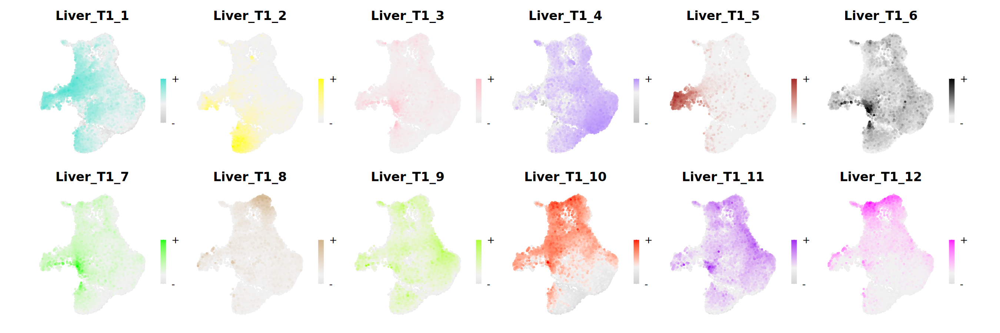

In [24]:
# get params for this plot
opts <- config$ModuleFeaturePlot
width <- opts$width; height <- opts$height

modules <- GetModules(seurat_obj)
n_mods <- length(unique(modules$module)) - 1 
nrow <- ceiling(n_mods / opts$ncol)

width <- width * opts$ncol 
height <- height * nrow

# set the plotting area for the notebook
options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)

if(opts$plot){
    
    # make a featureplot of hub scores for each module
    plot_list <- ModuleFeaturePlot(
        seurat_obj,
        reduction = gen_opts$reduction_plot,
        raster = opts$raster,
        raster_dpi = opts$raster_dpi,
        order_points = opts$order_points,
        restrict_range = FALSE
    )
    
    # stitch together with patchwork
    pdf(paste0(fig_dir, wgcna_name,'_MEs_featureplot.pdf'), width=width, height=height)
    print(wrap_plots(plot_list, ncol=opts$ncol))
    dev.off()

    print(wrap_plots(plot_list, ncol=opts$ncol))
    
}



### DotPlot

Scale for colour is already present.
Adding another scale for colour, which will replace the existing scale.
Warning message:
“Removed 87 rows containing missing values or values outside the scale range (`geom_point()`).”
Warning message:
“Removed 87 rows containing missing values or values outside the scale range (`geom_point()`).”


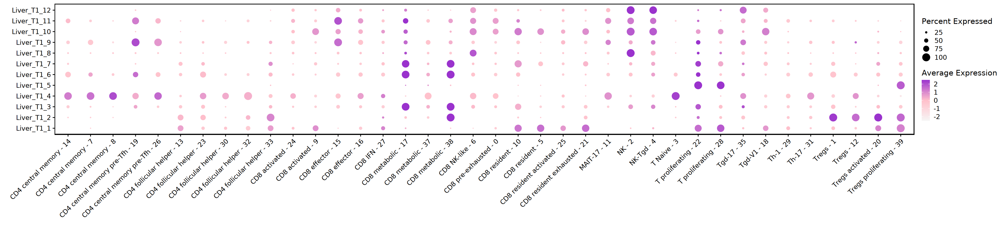

In [25]:
opts <- config$DotPlot

if(opts$plot){
    
    # determine width and height based on the number of modules & number of clusters:
    modules <- GetModules(seurat_obj)
    n_mods <- length(unique(modules$module)) - 1 
    n_clusters <- length(unique(seurat_obj@meta.data[,net_opts$group.by]))

    # define the width and height of the plot based on the number of modules
    # and the number of clusters
    if(opts$coord_flip){
         width <- ceiling(n_clusters * opts$scale_width)
         height <- ceiling(n_mods * opts$scale_height)
    } else{
        width <- ceiling(n_mods * opts$scale_width)
        height <- ceiling(n_clusters * opts$scale_height)
    }
    # min vals
    if(width < 6){ width <- 6}
    if(height < 6){ height <- 6}
    
    # set the plotting area for the notebook
    options(repr.plot.width = width, repr.plot.height = height, repr.plot.res = gen_opts$nb_dpi)
    
    # get MEs from seurat object
    MEs <- GetMEs(seurat_obj, harmonized=TRUE)
    modules <- GetModules(seurat_obj)
    mods <- levels(modules$module); mods <- mods[mods != 'grey']
    
    # add hMEs to Seurat meta-data:
    meta <- seurat_obj@meta.data
    seurat_obj@meta.data <- cbind(meta, MEs)
    
    # plot with Seurat's DotPlot function
    p <- Seurat::DotPlot(
        seurat_obj, 
        features=mods, 
        group.by = net_opts$group.by,
        dot.min = opts$dot.min
    )
    
    # flip the x/y axes, rotate the axis labels, and change color scheme:
    p <- p +
        RotatedAxis() +
        scale_color_gradient2(high=opts$high_color, mid = opts$mid_color, low=opts$low_color) + 
        xlab("") + ylab("") +  theme(
                axis.line.x = element_blank(),
                axis.line.y = element_blank(),
                panel.border = element_rect(colour = "black", fill=NA, linewidth=1),
                plot.title = element_text(hjust=0.5)
            ) 
    
    if(opts$coord_flip){
        p <- p + coord_flip()
    }
    
    # plot output
    pdf(paste0(fig_dir, wgcna_name,'_MEs_dotplot_', net_opts$group.by, '.pdf'), width=width, height=height)
    print(p)
    dev.off()
    
    seurat_obj@meta.data <- meta
    
    print(p)

}

## Network visualization

In this section, we create several visualizations of the co-expression network. We generate static network plots that will be saved as individual figures, and we also generate an interactive network plot using `plotly`.

* Hub gene network plots which highlight the most connected genes per module in the co-expression network. 
* Network plot of the entire co-expression plot using a UMAP-based network layout.

### Hub gene network plots

TODO: re-factor the following plotting code as a function (TidyModuleNetworkPlot). 

$plot
[1] TRUE

$n_hubs
[1] 25

$height
[1] 5

$width
[1] 5



Warning message in dir.create(paste0(fig_dir, "/hubgene_networks/")):
“'results//Liver_T1/figures///hubgene_networks' already exists”


[1] "Liver_T1_1"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_2"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_3"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_4"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_5"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_6"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_7"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_8"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_9"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_10"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_11"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”


[1] "Liver_T1_12"


Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the manual scale and the data's colour values.”
Warning message:
“No shared levels found between `names(values)` of the 

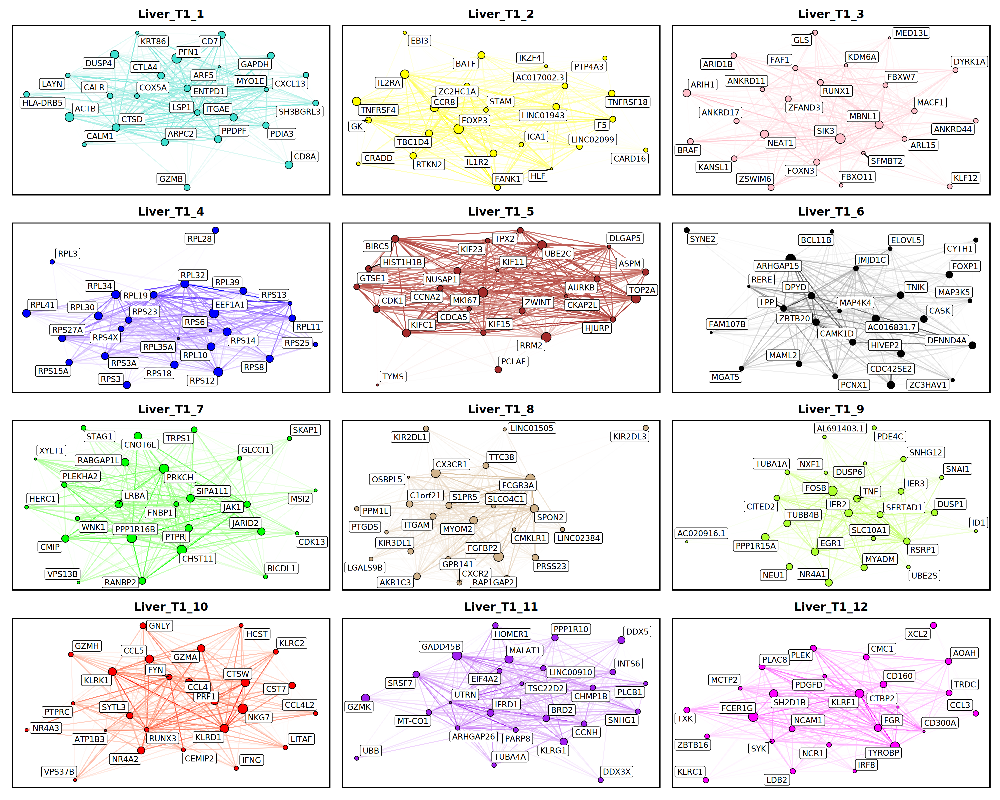

In [57]:

options(repr.plot.width = 20, repr.plot.height = 16, repr.plot.res = gen_opts$nb_dpi)  

opts <- config$ModuleNetworkPlot
print(opts)
if(opts$plot){
    
    #---------------------------------------------------------#
    # Hub gene network plots (CUSTOM)
    # Need to add this as a new function in hdWGCNA
    #---------------------------------------------------------#
    
    n_hubs <- opts$n_hubs
    n_edges <- n_hubs * 10
    
    dir.create(paste0(fig_dir, '/hubgene_networks/'))
    
    seurat_obj <- SetActiveWGCNA(seurat_obj, wgcna_name = wgcna_name)
    modules <- GetModules(seurat_obj) %>% subset(module != 'grey') %>% mutate(module = droplevels(module))
    
    # get module colors for plotting 
    mods <- levels(modules$module)
    mod_colors <- dplyr::select(modules, c(module, color)) %>% distinct()
    mod_cp <- mod_colors$color; names(mod_cp) <- as.character(mod_colors$module)
    
    # load the TOM:
    TOM <- GetTOM(seurat_obj, wgcna_name = wgcna_name)
    
    plot_list <- list()
    
    for(cur_mod in mods){
        
        print(cur_mod)
        
        cur_genes <- subset(modules, module == cur_mod) %>% .$gene_name
        
        hub_df <- GetHubGenes(seurat_obj, n_hubs=n_hubs) %>% subset(module == cur_mod)
        rownames(hub_df) <- hub_df$gene_name
        cur_hub_genes <- hub_df$gene_name
        
        cur_TOM <- TOM[cur_hub_genes, cur_hub_genes]
        cur_TOM[lower.tri(cur_TOM)] <- 0 
        
        cur_TOM_df <- reshape2::melt(cur_TOM) %>% 
          dplyr::rename(gene1 = Var1, gene2 = Var2, weight=value) %>%
          subset(gene1 != gene2) %>% 
          arrange(desc(weight)) %>% 
          slice_max(order_by = weight, n = n_edges)
    
        graph <- cur_TOM_df %>%
            igraph::graph_from_data_frame() %>%
            tidygraph::as_tbl_graph(directed=FALSE) %>% 
            tidygraph::activate(nodes)
        
        V(graph)$kME <- hub_df[V(graph)$name, 'kME']
        V(graph)$module <- modules[V(graph)$name,'module']
        
        lay <- ggraph::create_layout(graph, layout_nicely(graph))
        lay <- ggraph::create_layout(graph, layout_with_graphopt(graph))
        
        p <- ggraph(lay) + 
          ggrastr::rasterise(
            geom_edge_link(aes(alpha=scale01(weight), color=scale01(weight)), linewidth=0.5),
            dpi=400) + 
          geom_node_point(
            aes(fill=module, size=kME), color='black', shape=21
          ) +
          scale_colour_manual(values=mod_cp) +
          scale_fill_manual(values=mod_cp) +
          scale_edge_colour_gradient2(high=as.character(mod_cp[cur_mod]), low='lightgrey') +
          geom_node_label(aes(label=name), repel=TRUE, max.overlaps=Inf, fontface='italic') +
          NoLegend() + 
          ggtitle(paste0(cur_mod)) + 
          theme(
            plot.title = element_text(hjust=0.5),
            panel.border = element_rect(size=1, fill=NA, color='black')
        
          )
        
        pdf(paste0(fig_dir, '/hubgene_networks/', cur_mod, '_hubgene_network.pdf'), width=opts$width, height=opts$height)
        print(p) 
        dev.off()
        
        plot_list[[cur_mod]] <- p
    
    }

    ncol <- 3
    patch <- patchwork::wrap_plots(plot_list, ncol=ncol)
    n_rows <- ceiling(length(mods) / ncol)
    w <- 3 * ncol
    h <- 4.5 * n_rows
    
    pdf(paste0(fig_dir, '/hubgene_networks/', wgcna_name, '_combined_hubgene_network.pdf'), width=w, height=h)
    print(patch) 
    dev.off()
    
    print(patch)
}



### Interactive hub gene network plot

TODO: Add more info about each gene when highlighting? Gene funciton info, etc.

In [59]:
# source("~/analysis/SERPENTINE/bin/hdWGCNA_snakemake/scripts/plotting_functions.R")

opts <- config$ModuleNetworkPlotly
if(opts$plot){
    ModuleNetworkPlotly(
        seurat_obj,
        n_hubs = opts$n_hubs,
        plot_width = opts$plot_width,
        plot_height = opts$plot_height
    )
}

Warning message in RColorBrewer::brewer.pal(max(N, 3L), "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(max(N, 3L), "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(max(N, 3L), "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”
Warning message in RColorBrewer::brewer.pal(max(N, 3L), "Set2"):
“n too large, allowed maximum for palette Set2 is 8
Returning the palette you asked for with that many colors
”


HTML widgets cannot be represented in plain text (need html)

### Co-expression UMAP

TODO: Finish implement the plotting portion of this section.

In [60]:

opts <- config$RunModuleUMAP

seurat_obj <- RunModuleUMAP(
    seurat_obj,
    n_hubs = opts$n_hubs, 
    n_neighbors = opts$n_neighbors, 
    min_dist = opts$min_dist,
    spread = opts$spread,
    supervised = opts$supervised,
    target_weight = opts$target_weight
)

### Module-module correlations

In [61]:
# options(repr.plot.width = 9, repr.plot.height = 9, repr.plot.res = gen_opts$nb_dpi)

# # get MEs:
# MEs <- GetMEs(seurat_obj)
# modules <- GetModules(seurat_obj) 
# mods <- levels(modules$module); mods <- mods[mods != 'grey']
# MEs <- MEs[,mods]
# umap_df <- GetModuleUMAP(seurat_obj)

# # get module colors for plotting 
# mod_colors <- dplyr::select(modules, c(module, color)) %>% distinct()
# mod_cp <- mod_colors$color; names(mod_cp) <- as.character(mod_colors$module)

# # module sizes:
# mod_sizes <- table(modules$module)[mods]

# cor_cutoff <- 0.1

# # get correlation matrix
# cor_mat <- Hmisc::rcorr(as.matrix(MEs))$r
# #cor_mat[lower.tri(cor_mat)] <- NA

# # melt matrix and remove NAs
# cor_df <- reshape2::melt(cor_mat) %>% na.omit

# # remove self-edges
# cor_df <- cor_df %>% subset(!(Var1 == Var2))

# # remove weak edges:
# cor_df <- cor_df %>% subset(abs(value) >= cor_cutoff)


# graph <- igraph::graph_from_data_frame(cor_df) %>% 
#   tidygraph::as_tbl_graph(directed=FALSE) %>% 
#   tidygraph::activate(nodes) 

# # V(graph)$module <- modules[V(graph)$name,'module']
# V(graph)$module <- V(graph)$name
# V(graph)$ngenes <- as.numeric(mod_sizes)

# # calculate UMAP centroids for each module 
# centroid_df <- umap_df %>% 
#   dplyr::group_by(module) %>%
#   dplyr::summarise(UMAP1 = mean(UMAP1), UMAP2 = mean(UMAP2))
# rownames(centroid_df) <- centroid_df$module

# umap_layout <- centroid_df[names(V(graph)),] %>% dplyr::rename(c(x=UMAP1, y = UMAP2, name=module))


# # create the layout
# lay <- ggraph::create_layout(graph, umap_layout)

# p <- ggraph(lay) + 
#   ggrastr::rasterise(geom_point(
#     data = umap_df, aes(x=UMAP1, y=UMAP2), 
#     color=umap_df$color, alpha=0.1, size=umap_df$kME
#   ), dpi=300) +
#   geom_edge_link(aes(color=value, alpha=abs(value))) + 
#   geom_node_point(aes(fill=module, size=log2(ngenes)), color='black', shape=21) +
#   geom_node_label(aes(label=name), repel=TRUE, max.overlaps=Inf) +
#   #scale_colour_manual(values=mod_cp) +
#   scale_fill_manual(values=mod_cp) +
#   scale_edge_colour_gradient2(high='orange2', mid='white', low='dodgerblue')  + 
#   guides(color='none', fill='none', size='none', edge_alpha='none') + 
#   labs(edge_color = 'Cor')

# pdf(paste0(fig_dir, wgcna_name, '_module_corr_net.pdf'), width=8, height=8)
# print(p)
# dev.off()

# p


In [13]:
# this works (slowly) but the network edges etc do not render!
# ggplotly(p)

Warning message in geom2trace.default(dots[[1L]][[1L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomEdgePath() has yet to be implemented in plotly.
  If you'd like to see this geom implemented,
  Please open an issue with your example code at
  https://github.com/ropensci/plotly/issues”
Warning message in geom2trace.default(dots[[1L]][[2L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomEdgePath() has yet to be implemented in plotly.
  If you'd like to see this geom implemented,
  Please open an issue with your example code at
  https://github.com/ropensci/plotly/issues”
Warning message in geom2trace.default(dots[[1L]][[3L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomEdgePath() has yet to be implemented in plotly.
  If you'd like to see this geom implemented,
  Please open an issue with your example code at
  https://github.com/ropensci/plotly/issues”
Warning message in geom2trace.default(dots[[1L]][[4L]], dots[[2L]][[1L]], dots[[3L]][[1L]]):
“geom_GeomEdgePath() has yet to be

HTML widgets cannot be represented in plain text (need html)

## Gene set overlap analysis  

TODO: Finish implementing later?
Use EnrichR (hope it works!)

In [68]:
library(enrichR)

opts <- config$RunEnrichr

# Run EnrichR via hdWGCNA
seurat_obj <- hdWGCNA::RunEnrichr(
    seurat_obj,
    dbs = opts$dbs,
    max_genes = opts$max_genes
)

$dbs
[1] "GO_Biological_Process_2025"

$max_genes
[1] 200

Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Parsing results... Done.
Uploading data to Enrichr... Done.
  Querying GO_Biological_Process_2025... Done.
Par

# Part 4: Save the results

In [74]:
# save the Seurat object
saveRDS(seurat_obj, paste0(data_dir, wgcna_name, '_hdWGCNA.rds'))

In [72]:
# inspect the enrichr table:
enrichr_df <- GetEnrichrTable(seurat_obj, wgcna_name = wgcna_name) 

# write the output table(s)
subset(enrichr_df, P.value < 0.05) %>% 
    write.table(quote=FALSE, row.names=FALSE, sep='\t', file=paste0(data_dir, wgcna_name, '_hdWGCNA_enrichr_signif.tsv'))

enrichr_df %>% write.table(quote=FALSE, row.names=FALSE, sep='\t', file=paste0(data_dir, wgcna_name, '_hdWGCNA_enrichr_full.tsv'))

In [73]:
# create a combined table of the kME, degree, and rank (by kME)
hub_df <- GetHubGenes(seurat_obj, n_hubs=Inf)
degree_df <- GetDegrees(seurat_obj) %>% subset(gene_name %in% hub_df$gene_name) %>% select(-c(module))
df <- dplyr::left_join(hub_df, degree_df, by = "gene_name")
df <- df %>% group_by(module) %>% 
    mutate(rank_kME = rev(order(kME))) %>%
    select(c(gene_name, module, kME, rank_kME, degree, weighted_degree))

# write to output file
df %>% write.table(quote=FALSE, row.names=FALSE, sep='\t', file=paste0(data_dir, wgcna_name, '_hdWGCNA_modules.tsv'))